# Image Segmentation
Image segmentation is a computer vision technique that partitions a digital image into discrete groups of pixels or image segments. It is typically used to locate objects and boundaries in images, and is commonly used in object detection, 3D reconstruction and image editing workflows.<br>
<img src="Images/IS1.png" width="400" height="200"><br>
More precisely, image segmentation is the process of assigning a label to every pixel in an image such that pixels with the same label share certain characteristics.
<img src="Images/IS2.png" width="400" height="200"><br>
The original segment anything model is a milestone in computer vision that has become a foundational step for many high level downstream tasks like image segmentation, image captioning and image editing. But its high computational cost sometimes prevents it from wider applications in industry scenarios like those in edge devices. SAMs computational cost mainly comes from its transformer architecture.<br>
<img src="Images/IS3.png" width="400" height="200"><br>
As we can see in the image, SAM accepts either bounding box coordinates or single pixel coordinates, as well as an input image. Each of these inputs are encoded by an image encoder and a prompt encoder, respectively. They are then fed into the masked decoder, and SAM outputs the top three valid masks for that point or bounding box.<br>
<img src="Images/IS4.png" width="400" height="200"><br>
Fast SAM is a CNN based segment anything model trained using only 2% of the original data set published by the SAM authors, and achieves comparable performance on 32x32 images, but at 50 times higher the runtime speed. Prompting fast SAM also differ slightly from prompting the original SAM, and thus it automatically detects all masks in an image above a configurable confidence threshold, and then filters all the generated masks based on the prompts provided by the user.<br>

In [1]:
# !pip install ultralytics torch

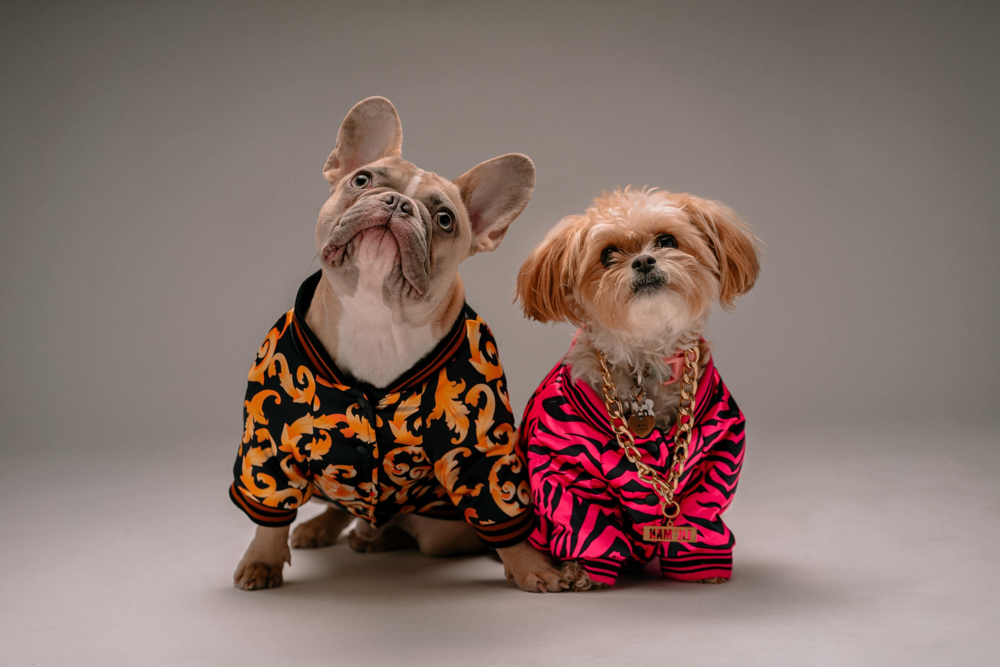

In [2]:
from PIL import Image
raw_image = Image.open("dogs.jpg")
raw_image

Resize the image to 1024 using the **`resize_image()`** method from utils library.

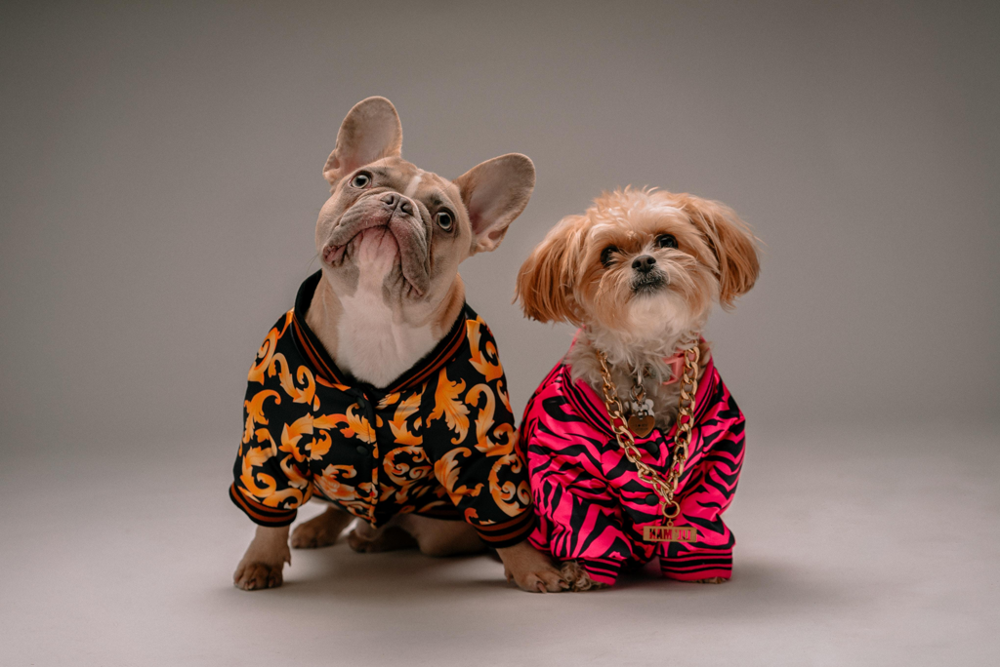

In [3]:
from utils import resize_image
resized_image = resize_image(raw_image, input_size=1024)
resized_image

If you don't have an access to GPU we can use the smaller version of SAM model called **FastSAM**. As the SAM model requires a significant memory resources to run.

In [4]:
import torch

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [6]:
from ultralytics import YOLO
model = YOLO('./FastSAM.pt')

Info about ['FastSAM'](https://docs.ultralytics.com/models/fast-sam/)

### Use the model
SAM can be used to create mask based on either a single set of pixel coordinates, a set of coordinates or bounding boxes. Here we will start by usign the SAM model to isolate the dog on the left, and to do this we will define a point on the image that the model will use as a starting point for the segmentation. For this use the utility function that we will use to check where the point we specify is located on the image. 

In [7]:
from utils import show_points_on_image

Since it is possible to specify multiple points when prompting the SAM model, we will define the input points using a nested list. The first coordinate refers to the x-axis and the second coordinates refers to y-axis.

In [8]:
input_points = [[350, 450]]

We can also define the input labels as either positive or negative. A positive point is included in the mask, and a negative point is excluded from the mask. For the first example let's use the positive point.

In [9]:
input_labels = [1] # positive point

From the custom function from the utils library we can visualize where that point is on the image.

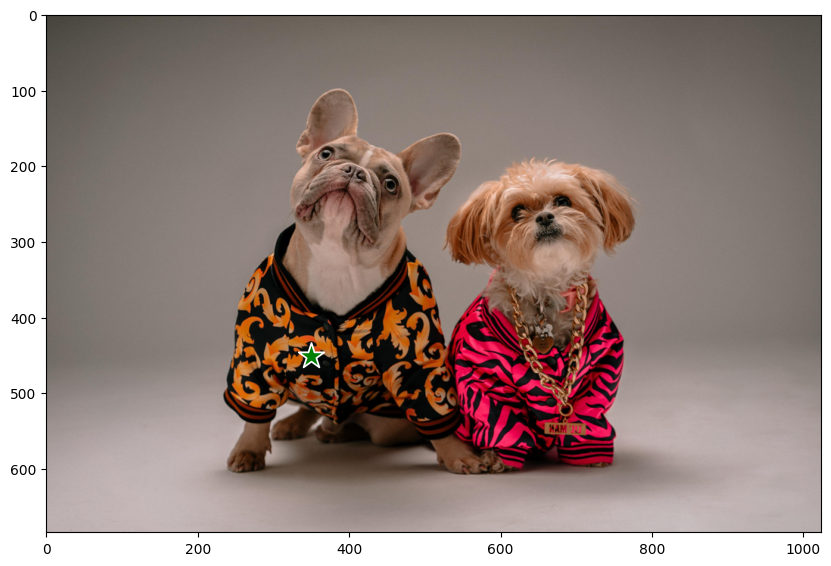

In [10]:
# Function written in the utils file
show_points_on_image(resized_image, input_points)

The green star on the image indicates the point we specified above, we will pass this information to the model so that it can generate the first mask.<br>
The first step in the process is to run the model on the image, this will segment the entire image into multiple masks that we can then filter down using our point prompt. 

In [11]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 8996.0ms
Speed: 89.4ms preprocess, 8996.0ms inference, 1294.3ms postprocess per image at shape (1, 3, 704, 1024)


We will now filter the masks that we generated based on this point we defined above.

In [12]:
from utils import format_results, point_prompt

In [13]:
results = format_results(results[0], 0)

In [14]:
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)

After generating the masks we can visualize them on the original image to make sure that they have been generated correctly.

In [15]:
from utils import show_masks_on_image

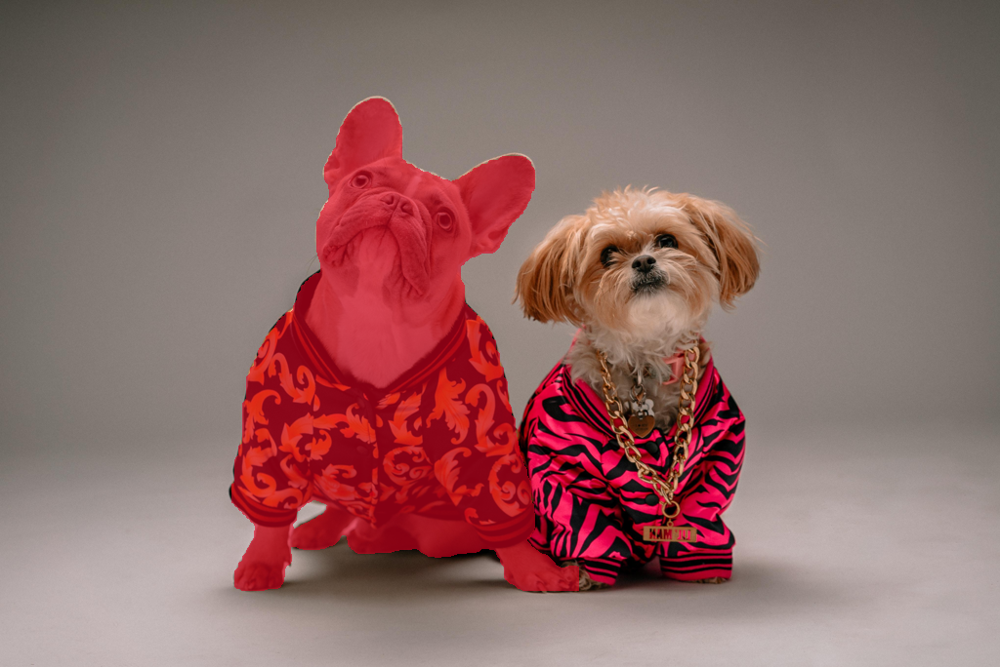

In [16]:
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

We can also specify multiple points if we want to get a larger mask. Now we will try to create mask for both of the dogs. This would be referred to as a semantic mask.

In [17]:
input_points = [[350, 450], [620, 450]]

As previously we will first specify two points as prompts to the SAM model. And specify each as a positive prompt.

In [18]:
input_labels = [1 , 1] # both positive points

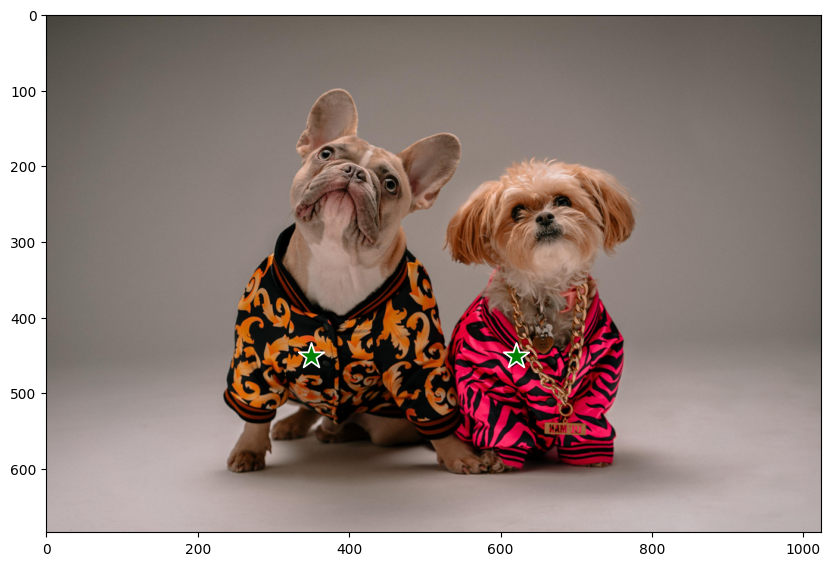

In [19]:
# Visualize the points defined before
show_points_on_image(resized_image, input_points)

In [20]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 7925.1ms
Speed: 2.5ms preprocess, 7925.1ms inference, 288.3ms postprocess per image at shape (1, 3, 704, 1024)


In [21]:
results = format_results(results[0], 0)

In [22]:
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)

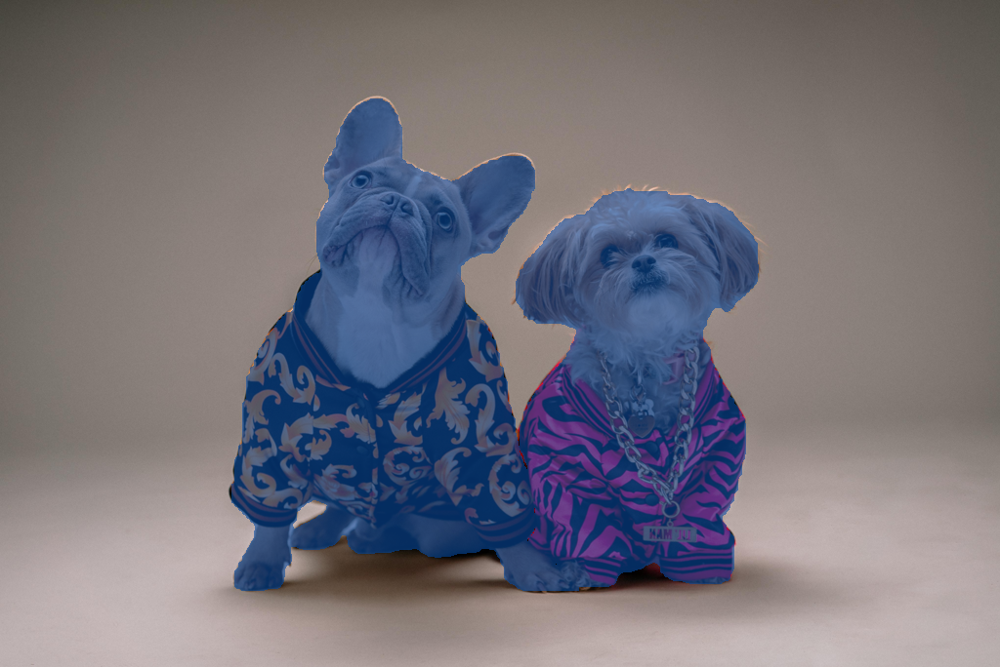

In [23]:
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

Uptill now we were using the positive prompt that tells the model what we want it to segment. To specify sub sections of an object, it may also be helpful to use negative prompts or prompts that tell the model what we do not want it to segment.<br>
Let's choose a 2D coordinate on the dog's jacket with a positive label and a 2D coordinate on the dog with a negative label to indicate to the model that we only want to segment the jacket on the dog. For this we will pass a list of 2D coordinates just as done before.

In [24]:
input_points = [[350, 450], [400, 300]]

This time we will specify zero for the negative labels.

In [25]:
input_labels = [1, 0] # positive prompt, negative prompt

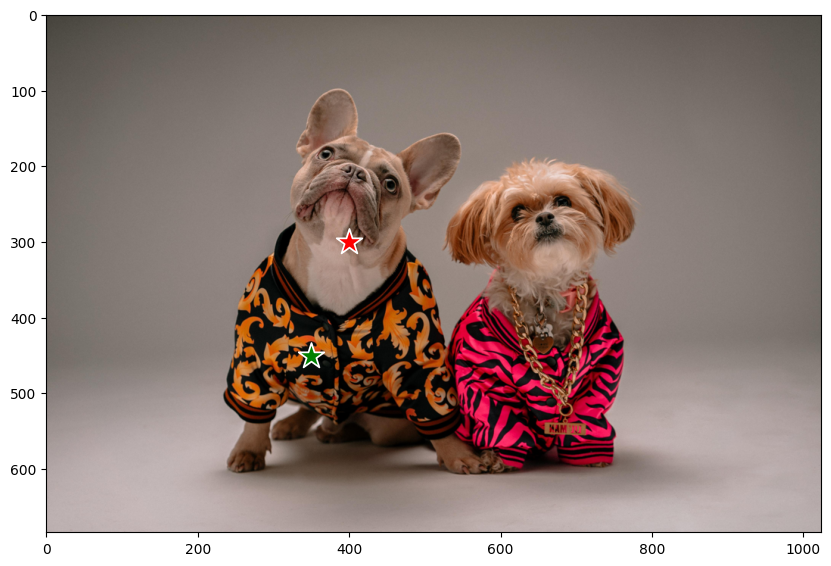

In [26]:
# Visualize the points defined before
show_points_on_image(resized_image, input_points, input_labels)

Here the gree star indicates positive prompt and the red star indicates the negative prompt. This will indicate to the model that we only want to segment the jacket. We will follow the same procedure to get the mask.

In [27]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 7938.6ms
Speed: 2.6ms preprocess, 7938.6ms inference, 296.9ms postprocess per image at shape (1, 3, 704, 1024)


In [28]:
results = format_results(results[0], 0)

In [29]:
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)

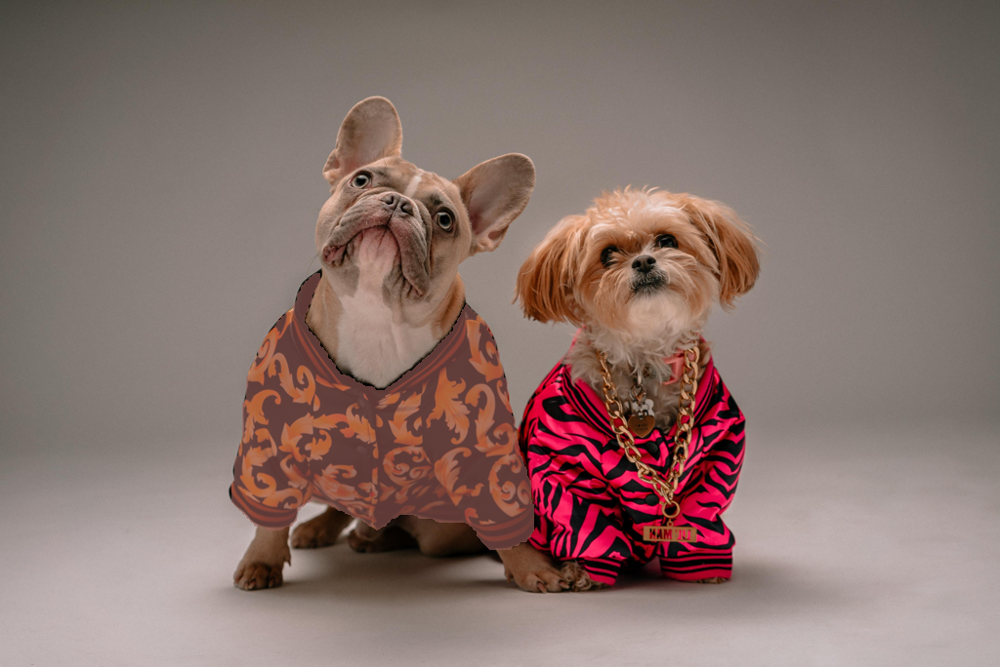

In [30]:
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

### Prompting with bounding boxes
While using ML models it is common to use **bounding boxes**. These are rectabgles overlaid on the image that are used to highlight an object. They are commonly used in object detection workflows. This time, instead of specifying a prompt point, we will specify a bounding box prompt to highlight the dog on the right. Bounding boxes are in the format **x_min, y_min, x_max, y_max**. Which represents the top left of the box as the first two coordinates, and the bottom right as the second two coordinates. 

In [31]:
from utils import box_prompt

In [32]:
# Set the coordinates for the box
# [xmin, ymin, xmax, ymax]
input_boxes = [530, 180, 780, 600]

In [33]:
from utils import show_boxes_on_image

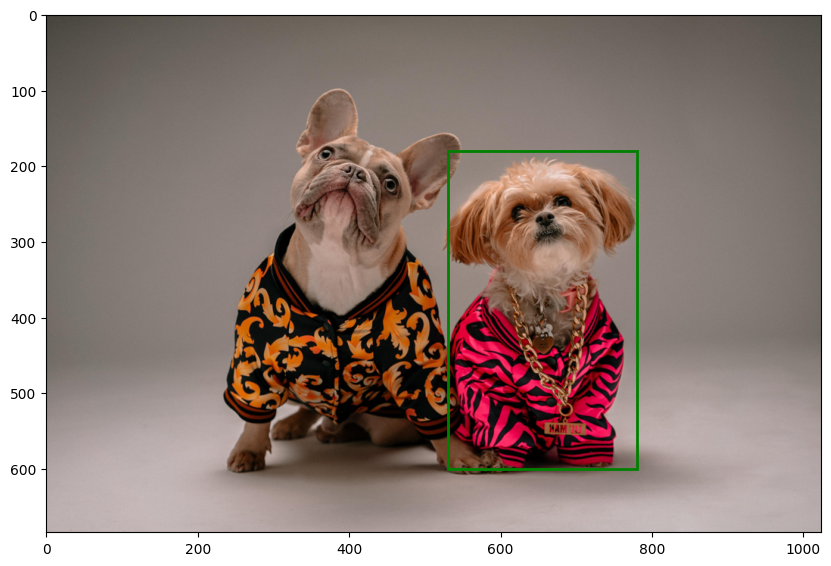

In [34]:
# Visualize the bounding box defined with the coordinates above
show_boxes_on_image(resized_image, [input_boxes])

Now we will try to isolate the mask from the total output of the model.

In [35]:
from utils import box_prompt

In [36]:
results = model(resized_image, device=device, retina_masks=True)


0: 704x1024 23 objects, 8323.9ms
Speed: 2.7ms preprocess, 8323.9ms inference, 203.1ms postprocess per image at shape (1, 3, 704, 1024)


In [37]:
#Generate the masks
masks = results[0].masks.data

In [38]:
masks

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        ...,

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0., 

In [39]:
# Convert to True/False booleans
masks = masks > 0

In [40]:
masks

tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [

Here we convert the masks to booleans instead of zeros and ones, as this is what the box prompt function expects. After this we will show the masks on the original image.

In [41]:
masks, _ = box_prompt(masks, input_boxes)

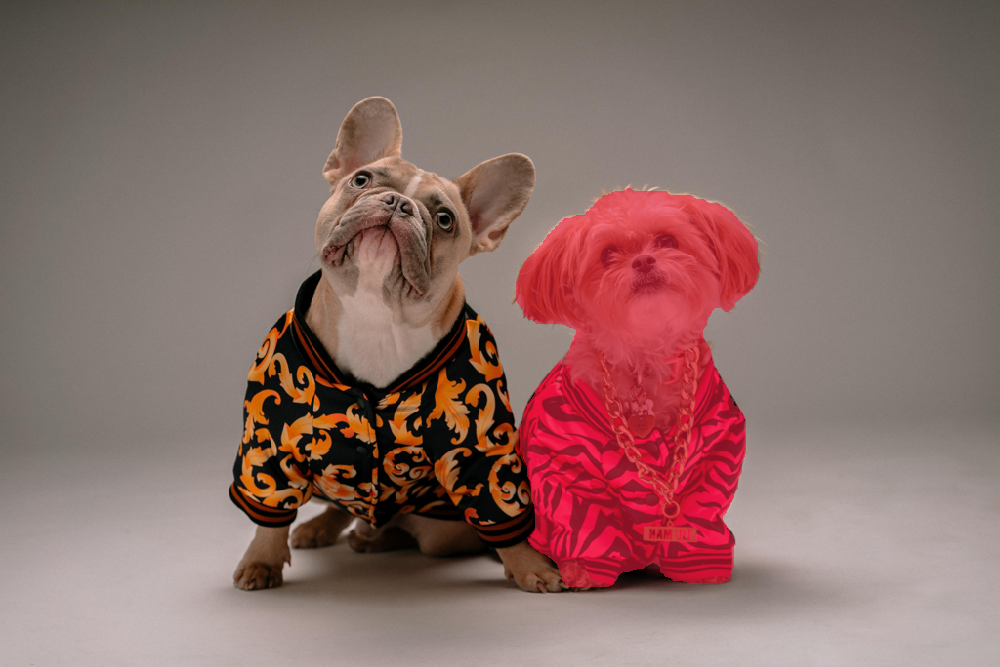

In [42]:
# Visualize the masks
show_masks_on_image(resized_image, [masks])

The actual model output, however, includes binary masks with related metadata like scores and logits. Binary masks are arrays of zeros and ones or true and false, where the ones or true indicate where the mask is and the zeros or false indicate where the mask is not.

In [43]:
# Print the segmentation mask, but in its raw format
masks

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [44]:
from matplotlib import pyplot as plt

To visualize the binary mask we will use matplotlib

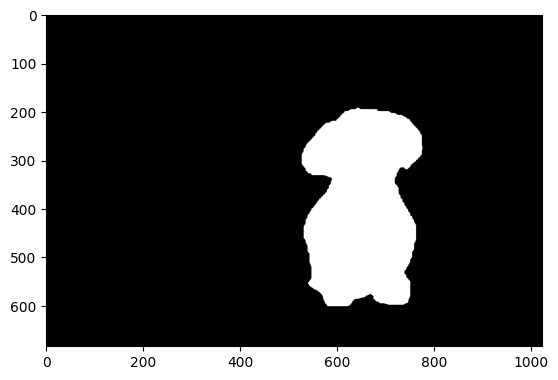

In [45]:
# Plot the binary mask as an image
plt.imshow(masks, cmap='gray')

In this image we can see that the white areas refer to the ones or true values, and the black area refers to the zeros or false values. These binary masks will serve as inputs in stable diffusion inpainting pipeline.

### How do these methods translate into real life applications?
2D point prompting may be relevant if we are working with an interactve UI, like a photo editing software, but most likely for this type of prompt, we are going to need some sort of human interaction with the model, which isn't always realistic for real life use cases. By using bounding boxes we can think of automating object detection as well as object semgentation pieces. To do this we wil need to create a model pipeline and pass the outputs of the object detection model as inputs to SAM. 

### Additional Resources

* How to use Comet for experiment tracking: [Quickstart Guide](https://colab.research.google.com/drive/1jj9BgsFApkqnpPMLCHSDH-5MoL_bjvYq?usp=sharing) and [Comet Docs](https://www.comet.com/docs/v2/).
* How to use newer versions of Stable Diffusion in this pipeline, additional tricks to improve your inpainting results, and a breakdown of the pipeline architecture:
  * [SAM + Stable Diffusion for Text-to-Image Inpainting](https://www.comet.com/site/blog/sam-stable-diffusion-for-text-to-image-inpainting/)
  * [Image Inpainting for SDXL 1.0 Base Model + Refiner](https://www.comet.com/site/blog/image-inpainting-for-sdxl-1-0-base-refiner/)